# Imports/Setup

In [197]:
%%capture
!pip install drain3

In [198]:
import tensorflow as tf
import pandas as pd
import sklearn
import re
import numpy as np
from copy import deepcopy
import tqdm
import joblib
import plotly.express as px
from drain3 import TemplateMiner
import logging
import os
import datetime
from datetime import timedelta
import sys
from collections import defaultdict
import plotly.graph_objects as go
from jupyter_dash import JupyterDash
from dash import dcc, html

In [199]:
logging.basicConfig(
    format='%(asctime)s %(levelname)s | %(message)s',
    level=logging.INFO,
    stream=sys.stdout
)

logger = logging.getLogger('notebook_logger')

# Get Data

In [200]:
def clean_logs(logs: pd.DataFrame):
  regexp = re.compile(
              r"""
              (?:               # Match all enclosed
              \d{4}-\d{2}-\d{2} # YYYY-MM-DD
              [\sT]             # Accept either a space or T
              \d{2}:\d{2}:\d{2} # HH:MM:SS
              ([.,]\d{3}|\s)    # Accept either a space or milliseconds
              )                 # End timestamp match
              | (?:\s{2,})      # Remove double spaces
              """, re.X)        # re.X enables comments and whitespace
  c_logs = deepcopy(logs)
  c_logs.loc[:, 'log'].replace(to_replace=regexp,
                                value=' ',
                                regex=True,
                                inplace=True)
  return c_logs

## Find and Prepare Data

In [201]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [202]:
def get_data(path: str) -> pd.DataFrame():
    ret_data = dict()
    logger.info('Building data dictionary ...')
    _, dirs, _ = next(os.walk(path))
    for directory in dirs:
        logging.info(f'directory found: {directory}')
        _, _, files = next(os.walk(f'{path}/{directory}'))
        for file in files:
            accpt_params = ['.csv', 'base', 'Logs']
            unaccpt_params = ['.~lock']
            if (all(p in file for p in accpt_params) and
                all(p not in file for p in unaccpt_params)):
                logging.info(f'file found: {file}')
                data = pd.read_csv(f'{path}/{directory}/{file}')
                data = clean_logs(data)                           # clean logs by removing internal timestamps
                data['timestamp'] = pd.to_datetime(data['timestamp'], unit='s')  # replace time since unix time with actual datetime obj
                data.set_index('timestamp', inplace=True)   # set index to be the timestamp
                data.sort_index(inplace=True)
                ret_data[directory] = data
    logger.info('...complete!')
    return ret_data

In [203]:
data = get_data('/content/drive/MyDrive/soaesb_logs')

2021-10-15 15:26:59,382 INFO | Building data dictionary ...
2021-10-15 15:26:59,391 INFO | directory found: 2021-10-07_1633636522
2021-10-15 15:26:59,394 INFO | file found: SoaesbLogsPipeline_base.csv
2021-10-15 15:26:59,643 INFO | directory found: 2021-10-07_1633645776
2021-10-15 15:26:59,648 INFO | file found: SoaesbLogsPipeline_base.csv
2021-10-15 15:27:02,195 INFO | directory found: 2021-10-08_1633668477
2021-10-15 15:27:02,201 INFO | file found: SoaesbLogsPipeline_base.csv
2021-10-15 15:27:02,917 INFO | directory found: 2021-10-12_1634016461
2021-10-15 15:27:02,921 INFO | file found: SoaesbLogsPipeline_base.csv
2021-10-15 15:27:05,605 INFO | directory found: 2021-10-12_1634026757
2021-10-15 15:27:05,612 INFO | file found: SoaesbLogsPipeline_base.csv
2021-10-15 15:27:06,462 INFO | directory found: 2021-10-12_1634053503
2021-10-15 15:27:06,473 INFO | file found: SoaesbLogsPipeline_base.csv
2021-10-15 15:27:20,838 INFO | directory found: 2021-10-12_1634068452
2021-10-15 15:27:20,840 

In [204]:
def remove_container_data(keyword):
  for key in data.keys():
    df = data[key]
    df = df[~df['container_name'].str.contains(keyword)]
    data[key] = df
    return data

In [205]:
data = remove_container_data('broker')

In [206]:
data[list(data.keys())[0]].head(500)

,container_name,log,label
timestamp,,,
2021-10-07 18:56:45.299000025,1.solr.soaesb,INFO (qtp1752461090-18) [ ] o.a.s.s.HttpSolr...,split-brain
2021-10-07 18:56:45.299999952,1.solr.soaesb,INFO (qtp1752461090-19) [ ] o.a.s.s.HttpSolr...,split-brain
2021-10-07 18:56:49.095999956,soaesb,[WARNING] 279/185647 (8) : Health check for se...,split-brain
2021-10-07 18:56:52.105000019,filebeat,Z\tINFO\t[monitoring]\tlog/log.go:144\tNon-ze...,split-brain
2021-10-07 18:56:52.105000019,filebeat,Z\tINFO\tlog/harvester.go:255\tHarvester star...,split-brain
...,...,...,...
2021-10-07 19:06:40.525000095,healthcheck,INFO HealthCheckService:106 - HEALTHY render ...,solr-dead-containers
2021-10-07 19:06:40.525000095,healthcheck,INFO HealthCheckService:106 - HEALTHY unicorn...,solr-dead-containers
2021-10-07 19:06:40.526000023,healthcheck,INFO HealthCheckService:106 - HEALTHY render ...,solr-dead-containers


## Train Drain Models

In [207]:
def train_drain(df_dict):
    drain_dict = dict()
    templates_dict = dict()
    for df_key in df_dict.keys():
        tm = TemplateMiner()
        df = df_dict[df_key]
        new_df = df.copy()
        for log in df['log']:
            tm.add_log_message(log)
        drain_dict[df_key] = tm

        new_df['log'] = new_df['log'].map(lambda log: tm.match(log).get_template())
        templates_dict[df_key] = new_df

    return drain_dict, templates_dict

In [208]:
drain_dict, templates_dict = train_drain(data)

2021-10-15 15:27:37,135 INFO | Starting Drain3 template miner
2021-10-15 15:27:37,139 INFO | Loading configuration from drain3.ini
2021-10-15 15:27:37,141 WARNING | config file not found: drain3.ini
2021-10-15 15:27:37,296 INFO | Starting Drain3 template miner
2021-10-15 15:27:37,297 INFO | Loading configuration from drain3.ini
2021-10-15 15:27:37,303 WARNING | config file not found: drain3.ini
2021-10-15 15:27:40,791 INFO | Starting Drain3 template miner
2021-10-15 15:27:40,794 INFO | Loading configuration from drain3.ini
2021-10-15 15:27:40,796 WARNING | config file not found: drain3.ini
2021-10-15 15:27:41,301 INFO | Starting Drain3 template miner
2021-10-15 15:27:41,303 INFO | Loading configuration from drain3.ini
2021-10-15 15:27:41,305 WARNING | config file not found: drain3.ini
2021-10-15 15:27:45,002 INFO | Starting Drain3 template miner
2021-10-15 15:27:45,004 INFO | Loading configuration from drain3.ini
2021-10-15 15:27:45,006 WARNING | config file not found: drain3.ini
2021-

# Data Processing

In [ ]:
# px.bar(logs['label'], x=logs['label'].unique(), y=logs['label'].value_counts(), template='plotly_white')

## Log Counts by Failure Mode

In [ ]:
from collections import defaultdict
counts = dict()
labels = set(df_logs_as_templates['label'].unique())
for label in labels:
    tmp_counts = defaultdict(int)
    tmp_df = df_logs_as_templates[df_logs_as_templates['label'] == label]
    for i in range(len(template_miner.drain.clusters)):
        tmp_counts[i] = 0
    for log in tmp_df['log']:
        tmp_counts[template_miner.match(log).cluster_id] += 1
    counts[label] = tmp_counts

In [ ]:
count_df = pd.DataFrame(counts)

In [ ]:
count_df.head(560)

,unreachable-ldap,split-brain,unreachable-unicorn,healthy,locked-ldap-account,core.soaesb-dead-soa-container,core.soaesb-dead-soa-process,newscene-bundle-stopped,zookeeper-dead-containers,solr-dead-containers,nitf-messaging-bundle-stopped,unreachable-render
0,0.0,0.0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,0.0,0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,0.0,0.0
2,0.0,0.0,0,0.0,0.0,0.0,0.0,0.0,0.0,3.0,0.0,0.0
3,0.0,0.0,0,0.0,0.0,0.0,0.0,0.0,0.0,10.0,0.0,0.0
4,0.0,0.0,0,0.0,0.0,0.0,0.0,0.0,0.0,6.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...
549,0.0,0.0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0
550,1.0,0.0,0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,3.0
551,0.0,0.0,0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
552,0.0,0.0,2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


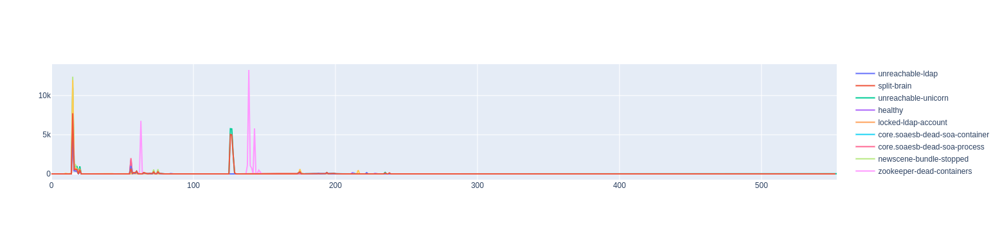

In [ ]:
import plotly.graph_objects as go

fig = go.Figure()

for label in labels:
    fig.add_trace(go.Scatter(
        x=count_df.index,
        y=count_df[label],
        name=label
    ))

# fig.update_layout(
#     width=2200,
#     height=1000
# )

fig.show()

## Time Interval Counts

In [209]:
template_df = templates_dict[list(templates_dict.keys())[2]]
template_miner = drain_dict[list(templates_dict.keys())[2]]

In [210]:
template_df['label'].unique()

array(['zookeeper-dead-containers', 'unreachable-ldap',
       'core.soaesb-dead-soa-container', 'solr-dead-containers',
       'split-brain', 'healthy', 'unreachable-unicorn',
       'unreachable-render'], dtype=object)

In [211]:
start_time = template_df.index.min()
end_time = template_df.index.max()
print(f'start time: {start_time}, end time: {end_time}')
print(f'time delta: {end_time - start_time}')
print(f'number of iterations: {int((end_time - start_time) / timedelta(seconds=30))}')

start time: 2021-10-08 02:27:47.107999802, end time: 2021-10-08 04:42:19.767000198
time delta: 0 days 02:14:32.659000396
number of iterations: 269


In [212]:
template_df[template_df['label']==template_df['label'].unique()[0]]

,container_name,log,label
timestamp,,,
2021-10-08 02:27:47.107999802,healthcheck,INFO SftpConnectionCheck:89 - Could not connec...,zookeeper-dead-containers
2021-10-08 02:27:47.108999968,healthcheck,INFO HealthCheckService:106 - <*> <*> <*>,zookeeper-dead-containers
2021-10-08 02:27:47.108999968,healthcheck,INFO HealthCheckService:106 - <*> <*> <*>,zookeeper-dead-containers
2021-10-08 02:27:47.108999968,healthcheck,INFO HealthCheckService:106 - <*> <*> <*>,zookeeper-dead-containers
2021-10-08 02:27:47.108999968,healthcheck,INFO HealthCheckService:106 - <*> <*> <*>,zookeeper-dead-containers
...,...,...,...
2021-10-08 02:39:00.247999907,1.master.broker.soaesb,ERROR [org.apache.activemq.artemis.core.server...,zookeeper-dead-containers
2021-10-08 02:39:00.325000048,solr-dependencies,Opening socket connection to server 1.zookeepe...,zookeeper-dead-containers
2021-10-08 02:39:01.325000048,solr-dependencies,"Session <*> for server null, unexpected error,...",zookeeper-dead-containers


In [213]:
# def get_hover_data(template_miner):
#   templates = []
#   for i in range(len(template_miner.drain.clusters)):

hd = ["NA"] * (len(template_miner.drain.clusters) + 1)

In [214]:
len(hd)

141

In [215]:
def build_time_int_chart_data(df, template_miner):
    labels = df['label'].unique()
    delta = timedelta(seconds=30)

    # check that all of the runtimes are equivalent
    time_delta_store = []
    for measure_label in labels:
        measure_df = df[df['label'] == measure_label]
        measure_start_time = measure_df.index.min()
        measure_end_time = measure_df.index.max()
        runtime = (measure_end_time - measure_start_time).floor(freq='T').to_pytimedelta()
        time_delta_store.append(runtime)

    bool_uniform_runtime = time_delta_store.count(time_delta_store[0]) == len(time_delta_store)

    if not bool_uniform_runtime: return None

    slider_data = dict()

    n_iter = int(time_delta_store[0] / timedelta(seconds=30))
    for i in range(n_iter - 1):
        iter_data = dict()
        for label in labels:
            iter_df = df[df['label'] == label]
            iter_start_time = iter_df.index.min() + i * delta
            iter_end_time = iter_start_time + delta
            iter_mask = (iter_df.index > iter_start_time) & (iter_df.index <=iter_end_time)
            iter_df = iter_df.loc[iter_mask]
            iter_counts = defaultdict(int)
            for j in range(len(template_miner.drain.clusters) + 1):
                iter_counts[j] = 0
            for log in iter_df['log']:
                template = template_miner.drain.match(log)
                iter_counts[template.cluster_id] += 1

                if (hd[template.cluster_id] == "NA"):
                  hd[template.cluster_id] = template.get_template()
                
            iter_data[label] = iter_counts
        slider_data[i] = pd.DataFrame.from_dict(iter_data).fillna(0)
        slider_data[i].sort_index()
        slider_data[i]['total_count'] = slider_data[i].sum(axis=1)
        slider_data[i]['template'] = hd

        expected_value = slider_data[i]['total_count'].mean()
        cut_off = expected_value + 2 * slider_data[i]['total_count'].std()
        slider_data[i] = slider_data[i][slider_data[i]['total_count'] < cut_off]
        slider_data[i].drop('total_count', axis=1, inplace=True)

            
    return slider_data

In [216]:
slider_data = build_time_int_chart_data(template_df, template_miner)

In [217]:
slider_data[0].head()

,zookeeper-dead-containers,unreachable-ldap,core.soaesb-dead-soa-container,solr-dead-containers,split-brain,healthy,unreachable-unicorn,unreachable-render,template
0,0,0,0,0,0,0,0,0,NA
1,3,2,3,2,3,3,3,3,INFO SftpConnectionCheck:89 - Could not connec...
3,1,0,0,0,0,0,0,0,"INFO HealthCheckService:106 - [{""container"":""d..."
4,1,0,0,0,0,0,0,0,WARN (main-SendThread(1.zookeeper.soaesb.soaes...
5,1,0,1,1,0,0,0,0,Z INFO input/input.go:167 Stopping Input: <*>


In [218]:
fig = go.Figure()
labels = list(slider_data[0].keys())


for runtime in slider_data.keys():
    # hover_data = []
    for idx in slider_data[runtime].index:
        try:
            cluster = template_miner.drain.cluster[idx]
        except:
            continue
        # hover_data.append(cluster.get_template())
    for label in labels:
        fig.add_trace(
            go.Bar(
                visible=False,
                x=slider_data[runtime].index,
                y=slider_data[runtime][label],
                hoverinfo = "text",
                text=slider_data[runtime]['template'],
                name=label
            )
        )

for i in range(11):
    fig.data[i].visible = True
    
steps = []
j = 0
for i in range(0, len(fig.data), len(labels)):
    j += 1
    step = dict(
        method='update',
        args=[{'visible': [False] * len(fig.data)},
              {'title': f'{j * 30} seconds into failure modes'}],
    )
    for k in range(i, i + len(labels)):
        step['args'][0]['visible'][k]= True
    steps.append(step)
               
    sliders = [dict(
        active = 20,
        currentvalue={'prefix': '30s window: '},
        pad={'t': 10},
        steps=steps
    )]

fig.update_layout(template='plotly_white', sliders=sliders, height = 500, barmode='stack')
fig.show()

In [ ]:
previous_timestamp = df_logs_as_templates.index.min()
breaks = []
for timestamp in df_logs_as_templates.index:
    if timestamp - previous_timestamp > timedelta(minutes=15):
        breaks.append(timestamp)
    previous_timestamp = timestamp

In [ ]:
cleaned_logs['log'] = cleaned_logs['log'].str.lower()
cleaned_logs['log'] = cleaned_logs['log'].str.replace(',', ' ')

In [ ]:
clean_tokens = cleaned_logs['log'].str.split(' ', expand=True).stack()
unique_tokens = list(clean_tokens.unique())
unique_tokens_pd = pd.DataFrame(unique_tokens)

In [ ]:
len(unique_tokens_pd)

50147

In [ ]:
vocab, index = {}, 1  # start indexing from 1
vocab['<pad>'] = 0  # add a padding token
for token in unique_tokens:
  if token not in vocab:
    vocab[token] = index
    index += 1
vocab_size = len(vocab)

In [ ]:
inverse_vocab = {index: token for token, index in vocab.items()}

In [ ]:
example_word_log_1 = list(cleaned_logs['log'].iloc[0].split(' '))
example_sequence = [vocab[word] for word in example_word_log_1]

In [ ]:
window_size = 2
positive_skip_grams, _ = tf.keras.preprocessing.sequence.skipgrams(
      example_sequence,
      vocabulary_size=vocab_size,
      window_size=window_size,
      negative_samples=0)

In [ ]:
# Get target and context words for one positive skip-gram.
target_word, context_word = positive_skip_grams[0]

# Set the number of negative samples per positive context.
num_ns = 4

context_class = tf.reshape(tf.constant(context_word, dtype="int64"), (1, 1))
negative_sampling_candidates, _, _ = tf.random.log_uniform_candidate_sampler(
    true_classes=context_class,  # class that should be sampled as 'positive'
    num_true=1,  # each positive skip-gram has 1 positive context class
    num_sampled=num_ns,  # number of negative context words to sample
    unique=True,  # all the negative samples should be unique
    range_max=vocab_size,  # pick index of the samples from [0, vocab_size]
    seed=0,  # seed for reproducibility
    name="negative_sampling"  # name of this operation
)

2021-10-14 14:19:24.360124: I tensorflow/core/platform/cpu_feature_guard.cc:142] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2021-10-14 14:19:24.361279: I tensorflow/compiler/jit/xla_gpu_device.cc:99] Not creating XLA devices, tf_xla_enable_xla_devices not set
2021-10-14 14:19:24.361483: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:941] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-10-14 14:19:24.362014: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1720] Found device 0 with properties: 
pciBusID: 0000:01:00.0 name: NVIDIA GeForce RTX 2070 SUPER computeCapability: 7.5
coreClock: 1.8GHz coreCount: 40 deviceMemorySize: 7.79GiB deviceMemoryBandwidth: 417.29GiB/s
2021-10-1

In [ ]:
# Add a dimension so you can use concatenation (on the next step).
negative_sampling_candidates = tf.expand_dims(negative_sampling_candidates, 1)

# Concat positive context word with negative sampled words.
context = tf.concat([context_class, negative_sampling_candidates], 0)

# Label first context word as 1 (positive) followed by num_ns 0s (negative).
label = tf.constant([1] + [0]*num_ns, dtype="int64")

# Reshape target to shape (1,) and context and label to (num_ns+1,).
target = tf.squeeze(target_word)
context = tf.squeeze(context)
label = tf.squeeze(label)

In [ ]:
cleaned_logs_labels = tf.convert_to_tensor(cleaned_logs["label"])
cleaned_logs_tensor = tf.convert_to_tensor(cleaned_logs["log"])

In [ ]:
text_ds = tf.data.Dataset.from_tensor_slices(cleaned_logs_tensor).filter(lambda x: tf.cast(tf.strings.length(x), bool))

In [ ]:
text_ds.batch(1024)

<BatchDataset shapes: (None,), types: tf.string>

In [ ]:
def standardize_log(log):
  lowercase = tf.strings.lower(log)
  return tf.strings.regex_replace(lowercase,
                                  '[%s]' % re.escape(string.punctuation), ' ')


def generate_training_data(sequences, window_size, num_ns, vocab_size):
  targets, contexts, labels = [], [], []

  sampling_table = tf.keras.preprocessing.sequence.make_sampling_table(vocab_size)

  for sequence in tqdm.tqdm(sequences):

    positive_skip_grams, _ = tf.keras.preprocessing.sequence.skipgrams(
          sequence,
          vocabulary_size=vocab_size,
          sampling_table=sampling_table,
          window_size=window_size,
          negative_samples=0)
    
    for target_word, context_word in positive_skip_grams:
      context_class = tf.expand_dims(
          tf.constant([context_word], dtype="int64"), 1)
      negative_sampling_candidates, _, _ = tf.random.log_uniform_candidate_sampler(
          true_classes=context_class,  # class that should be sampled as 'positive'
          num_true=1,  # each positive skip-gram has 1 positive context class
          num_sampled=num_ns,  # number of negative context words to sample
          unique=True,  # all the negative samples should be unique
          range_max=vocab_size,  # pick index of the samples from [0, vocab_size]
          seed=0,  # seed for reproducibility
          name="negative_sampling"  # name of this operation
      )

      # Add a dimension so you can use concatenation (on the next step).
      negative_sampling_candidates = tf.expand_dims(negative_sampling_candidates, 1)

      # Concat positive context word with negative sampled words.
      context = tf.concat([context_class, negative_sampling_candidates], 0)

      # Label first context word as 1 (positive) followed by num_ns 0s (negative).
      label = tf.constant([1] + [0]*num_ns, dtype="int64")

      targets.append(target_word)
      contexts.append(context)
      labels.append(label)

  return targets, contexts, labels

In [ ]:
# Define the vocabulary size and number of words in a sequence.
vocab_size = 12000
sequence_length = 256

# Use the TextVectorization layer to normalize, split, and map strings to
# integers. Set output_sequence_length length to pad all samples to same length.
vectorize_layer = tf.keras.layers.experimental.preprocessing.TextVectorization(
    standardize=standardize_log,
    max_tokens=vocab_size,
    output_mode='int',
    output_sequence_length=sequence_length)

In [ ]:
vectorize_layer.adapt(text_ds.batch(1024))

2021-10-14 14:19:34.575165: I tensorflow/compiler/mlir/mlir_graph_optimization_pass.cc:116] None of the MLIR optimization passes are enabled (registered 2)
2021-10-14 14:19:34.594568: I tensorflow/core/platform/profile_utils/cpu_utils.cc:112] CPU Frequency: 4200000000 Hz


In [ ]:
len(vectorize_layer.get_vocabulary())

12000

In [ ]:
# Save the created vocabulary for reference.
inverse_vocab = vectorize_layer.get_vocabulary()
print(inverse_vocab[:20])

['', '[UNK]', 'java', 'at', '1', 'info', '2', 'healthcheckservice', '0', 'org', 'apache', '106', 'status', 'jar', 'to', 'container', 'zookeeper', 'camel', '4', 'up']


In [ ]:
# Vectorize the data in text_ds.
text_vector_ds = text_ds.batch(1024).prefetch(tf.data.AUTOTUNE).map(vectorize_layer).unbatch()

In [ ]:
sequences = list(text_vector_ds.as_numpy_iterator())
print(len(sequences))

209363


In [ ]:
for seq in sequences[:5]:
  print(f"{seq} => {[inverse_vocab[i] for i in seq]}")

[   5 2463  706   98    6  139  153   53   46  238   26  554  245  153
   46   54   88   49   58   53  627  238 2177  113 2536    9   10   22
   83 1998 2177    1 2534   81 2551   22   26  153   46   54   88   96
  676   81 2561   62   81   90 1999   22   26  153   46   54   88   28
 2554   83 2543    1    0    0    0    0    0    0    0    0    0    0
    0    0    0    0    0    0    0    0    0    0    0    0    0    0
    0    0    0    0    0    0    0    0    0    0    0    0    0    0
    0    0    0    0    0    0    0    0    0    0    0    0    0    0
    0    0    0    0    0    0    0    0    0    0    0    0    0    0
    0    0    0    0    0    0    0    0    0    0    0    0    0    0
    0    0    0    0    0    0    0    0    0    0    0    0    0    0
    0    0    0    0    0    0    0    0    0    0    0    0    0    0
    0    0    0    0    0    0    0    0    0    0    0    0    0    0
    0    0    0    0    0    0    0    0    0    0    0    0    0    0
    0 

In [ ]:
num_ns=4

In [ ]:
targets, contexts, labels = generate_training_data(
    sequences=sequences,
    window_size=2,
    num_ns=num_ns,
    vocab_size=vocab_size)

targets = np.array(targets)
contexts = np.array(contexts)[:,:,0]
labels = np.array(labels)

print('\n')
print(f"targets.shape: {targets.shape}")
print(f"contexts.shape: {contexts.shape}")
print(f"labels.shape: {labels.shape}")

100%|██████████| 209363/209363 [08:52<00:00, 393.04it/s] 




targets.shape: (2072518,)
contexts.shape: (2072518, 5)
labels.shape: (2072518, 5)


In [ ]:
joblib.dump(targets, 'results/targets.joblib')
joblib.dump(contexts, 'results/contexts.joblib')
joblib.dump(labels, 'results/labels.joblib')

['results/labels.joblib']

In [ ]:
BATCH_SIZE = 1024
BUFFER_SIZE = 10000
dataset = tf.data.Dataset.from_tensor_slices(((targets, contexts), labels))
dataset = dataset.shuffle(BUFFER_SIZE).batch(BATCH_SIZE, drop_remainder=True)
print(dataset)

<BatchDataset shapes: (((1024,), (1024, 5)), (1024, 5)), types: ((tf.int64, tf.int64), tf.int64)>


In [ ]:
dataset = dataset.cache().prefetch(buffer_size=tf.data.AUTOTUNE)
print(dataset)

<PrefetchDataset shapes: (((1024,), (1024, 5)), (1024, 5)), types: ((tf.int64, tf.int64), tf.int64)>


In [ ]:
class Word2Vec(tf.keras.Model):
  def __init__(self, vocab_size, embedding_dim):
    super(Word2Vec, self).__init__()
    self.target_embedding = tf.keras.layers.Embedding(
        vocab_size,
        embedding_dim,
        input_length=1,
        name="w2v_embedding"
    )
    self.context_embedding = tf.keras.layers.Embedding(
        vocab_size,
        embedding_dim,
        input_length=4+1
    )

  def call(self, pair):
    target, context = pair
    # target: (batch, dummy?)  # The dummy axis doesn't exist in TF2.7+
    # context: (batch, context)
    if len(target.shape) == 2:
      target = tf.squeeze(target, axis=1)
    # target: (batch,)
    word_emb = self.target_embedding(target)
    # word_emb: (batch, embed)
    context_emb = self.context_embedding(context)
    # context_emb: (batch, context, embed)
    dots = tf.einsum('be,bce->bc', word_emb, context_emb)
    # dots: (batch, context)
    return dots

In [ ]:
embedding_dim = 512
w2v = Word2Vec(vocab_size, embedding_dim)
w2v.compile(optimizer='adam',
            loss=tf.keras.losses.CategoricalCrossentropy(from_logits=True),
            metrics=['accuracy'])

In [ ]:
w2v.fit(dataset, epochs=3)

Epoch 1/3


2021-10-13 02:08:53.266414: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcublas.so.11


  3/240 [..............................] - ETA: 17s - loss: 1.6075 - accuracy: 0.2422

2021-10-13 02:08:53.654830: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcublasLt.so.11


240/240 [==============================] - 14s 54ms/step - loss: 1.2718 - accuracy: 0.7627
Epoch 2/3
240/240 [==============================] - 13s 53ms/step - loss: 0.3687 - accuracy: 0.9445
Epoch 3/3
240/240 [==============================] - 13s 54ms/step - loss: 0.1457 - accuracy: 0.9686


In [ ]:
joblib.dump(w2v.get_layer('w2v_embedding').get_weights()[0], "results/w2v_embeddings.joblib")

['results/w2v_embeddings.joblib']

# Random Forest

## Prepare embeddings for Random Forest

Each embedding has a length of 512 (embedding_dim) and there are 256 embeddings per log. The logs are batched 1024 at a time. We will need to pass in a single vector to the random forest classifier for each batch. 

In [ ]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix
from sklearn.decomposition import PCA

weights = joblib.load('results/w2v_embeddings.joblib')

In [ ]:
label_encoder = LabelEncoder()
label_encoder = label_encoder.fit(cleaned_logs['label'].unique())

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(
    cleaned_logs['log'], cleaned_logs['label'], test_size=0.25, random_state=0, shuffle=False)

In [ ]:
X_test

11960      error [org.apache.activemq.artemis.core.serv...
11961      error [org.apache.activemq.artemis.core.serv...
11962      error [org.apache.activemq.artemis.core.serv...
11963      error [org.apache.activemq.artemis.core.serv...
11964     info healthcheckservice:106 - healthy unicorn...
                               ...                        
15942      error 1 ...
15943     info sftpconnectioncheck:89 - could not conne...
15944      error [org.apache.activemq.artemis.core.serv...
15945      error [org.apache.activemq.artemis.core.serv...
15946     info healthcheckservice:106 - healthy unicorn...
Name: log, Length: 3987, dtype: object

In [ ]:
def embed_tokens(tensor):
  return tf.constant(weights[tensor.numpy()])

In [ ]:
encoded_seq = vectorize_layer(X_train[0:1024])

In [ ]:
batch_tensor = tf.map_fn(embed_tokens, encoded_seq, fn_output_signature=tf.float32)

In [ ]:
tf_avg_tokens = tf.math.reduce_mean(batch_tensor, axis=1)
tf_avg_embed_dims = tf.math.reduce_mean(tf_avg_tokens, axis=1)
tf_avg_embed_dims

<tf.Tensor: shape=(1024,), dtype=float32, numpy=
array([-0.00098837, -0.00114544, -0.00116906, ..., -0.00122365,
       -0.0010807 , -0.00116096], dtype=float32)>

In [ ]:
def rf_data_gen(X, y):
    
    batch_size = 75
    n_iters = int(len(X) / batch_size)
    samples = []
    labels = []
        
    for i in range(n_iters):
        label = label_encoder.transform(y[i*batch_size:(i + 1)*batch_size])
        encoded_seq = vectorize_layer(X[i*batch_size:(i + 1)*batch_size])
        batch_embeddings = tf.map_fn(embed_tokens, encoded_seq, fn_output_signature=tf.float32)
        tf_avg_tokens = tf.math.reduce_mean(batch_embeddings, axis=1)
        ret = tf.math.reduce_mean(tf_avg_tokens, axis=1)
        samples.append(tf_avg_tokens)
        labels.append(label)
    
    return samples, labels

In [ ]:
rf_cls = RandomForestClassifier(warm_start = True)

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(
        cleaned_logs['log'],
        cleaned_logs['label'],
        test_size = 0.25,
        random_state = 42,
        shuffle = False)

In [ ]:
s, l = rf_data_gen(np.array(X_train), np.array(y_train))

In [ ]:
rf_cls.fit(s, l)

ValueError: Found array with dim 3. Estimator expected <= 2.

In [ ]:
s_pred, l_pred = rf_data_gen(np.array(X_test), np.array(y_test))

In [ ]:
preds = rf_cls.predict(s_pred)

In [ ]:
y_test

11960    core.soaesb-dead-soa-container
11961    core.soaesb-dead-soa-container
11962    core.soaesb-dead-soa-container
11963    core.soaesb-dead-soa-container
11964    core.soaesb-dead-soa-container
                      ...              
15942                unreachable-render
15943                unreachable-render
15944                unreachable-render
15945                unreachable-render
15946                unreachable-render
Name: label, Length: 3987, dtype: object

In [ ]:
cm = confusion_matrix(preds, l_pred)

In [ ]:
fig = px.imshow(
    cm,
    x = logs['label'].unique(),
    y = logs['label'].unique()
)

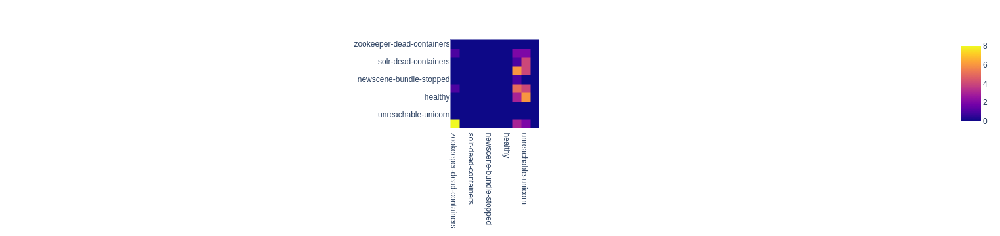

In [ ]:
fig.show()

In [ ]:
def train_random_forest(num_of_epochs: int):
    for j in tqdm.trange(num_of_epochs):
        train_gen = rf_data_gen(X_train, y_train)
        for X, y in train_gen:
            print(y.shape)
            rf_cls.fit(X, y)
            rf_cls.n_estimators += 1

In [ ]:
train_random_forest(10)

In [ ]:
def test_random_forest():
    y_preds = []
    test_gen = rf_data_gen(X_test, y_test)
    for X, _ in test_gen:
        print(X.shape)
        y_pred = rf_cls.predict(X)
        print(y_pred.shape)
        y_preds.append(y_pred)

In [ ]:
test_random_forest()

In [ ]:

# def train_random_forest(batch_size):
#   r = int(len(X_train) / batch_size)
#   for i in range(1, r + 1):
#     encoded_seq = vectorize_layer(X_train[(i-1)*batch_size:i*batch_size])
#     label = label_encoder.transform(y_train[(i-1)*batch_size:i*batch_size])

#     input = tf.map_fn(embed_tokens, encoded_seq, fn_output_signature=tf.float32).numpy()
    
#     for j in tqdm.trange(len(input), desc=f"Iteration {i}/{r}"):
#       # new_input = pca.fit_transform(input[j]).reshape(256,)
#       #new_input = pca.transform(input[j]).reshape(256, )
#       rf_clf.fit([input], [label[j]]) # * 256)

#     if (r >= 1):
#       break

# def test_random_forest(batch_size):
#   y_pred = []
#   r = int(len(X_test) / batch_size)
#   for i in range(1, r + 1):
#     encoded_seq = vectorize_layer(X_test[(i-1)*batch_size:i*batch_size])

#     input = tf.map_fn(embed_tokens, encoded_seq, fn_output_signature=tf.float32).numpy()
    
#     for j in tqdm.trange(len(input), desc=f"Iteration {i}/{r}"):
#       #new_input = pca.transform(input[j]).reshape(256, )
#       y_pred.append(rf_clf.predict([input])[0])

#   return y_pred

In [ ]:
weights = w2v.get_layer('w2v_embedding').get_weights()[0]
train_random_forest(1024)

# CNN

In [ ]:
from tensorflow.keras import datasets, layers, models

In [ ]:
model = models.Sequential()
model.add(layers.Conv2D(75, (3, 3), activation='relu', input_shape=(75, 256, 512)))
model.add(layers.MaxPooling2D((2, 2)))
model.add(layers.Conv2D(150, (3, 3), activation='relu'))
model.add(layers.MaxPooling2D((2, 2)))
model.add(layers.Conv2D(150, (3, 3), activation='relu'))
model.add(layers.Flatten())
model.add(layers.Dense(150, activation='relu'))
model.add(layers.Dense(10))

In [ ]:
model.summary()

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_3 (Conv2D)            (None, 73, 254, 75)       345675    
_________________________________________________________________
max_pooling2d_2 (MaxPooling2 (None, 36, 127, 75)       0         
_________________________________________________________________
conv2d_4 (Conv2D)            (None, 34, 125, 150)      101400    
_________________________________________________________________
max_pooling2d_3 (MaxPooling2 (None, 17, 62, 150)       0         
_________________________________________________________________
conv2d_5 (Conv2D)            (None, 15, 60, 150)       202650    
_________________________________________________________________
flatten (Flatten)            (None, 135000)            0         
_________________________________________________________________
dense (Dense)                (None, 150)              

In [ ]:
model.compile(optimizer='adam',
              loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),
              metrics=['accuracy'])

In [ ]:
def cnn_data_gen(X, y):
    
    batch_size = 75
    n_iters = int(len(X) / batch_size)
        
    for i in range(n_iters):
        label = label_encoder.transform(y[i*batch_size:(i + 1)*batch_size])
        encoded_seq = vectorize_layer(X[i*batch_size:(i + 1)*batch_size])
        batch_embeddings = tf.map_fn(embed_tokens, encoded_seq, fn_output_signature=tf.float32)
    
        yield batch_embeddings, label[0]

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(
        cleaned_logs['log'],
        cleaned_logs['label'],
        test_size = 0.25,
        random_state = 42,
        shuffle = False)

In [ ]:
X_train = vectorize_layer(X_train)
X_train = tf.map_fn(embed_tokens, X_train, fn_output_signature=tf.float32)

In [ ]:
X_train

<tf.Tensor: shape=(11960, 256), dtype=int64, numpy=
array([[ 288, 1472,   64, ...,    0,    0,    0],
       [ 172,   46,  528, ...,    0,    0,    0],
       [ 284,   37,   73, ...,    0,    0,    0],
       ...,
       [  26,   25,   38, ...,    0,    0,    0],
       [  26,   25,   38, ...,    0,    0,    0],
       [  34,  106,   34, ...,    5,    6,    7]])>

In [ ]:
history = model.fit(train_images, train_labels, epochs=10, 
                    validation_data=(test_images, test_labels))